<div class="usecase-title">Business energy consumption</div>

<div class="usecase-authors"><b>Authored by: </b> Ruofeng QIU</div>

<div class="usecase-duration"><b>Duration:</b> 120 mins</div>

<div class="usecase-level-skill">
    <div class="usecase-level"><b>Level: </b>Intermediate</div>
    <div class="usecase-skill"><b>Pre-requisite Skills: </b>Python, Machine  Learning, Data Wrangling</div>
</div>

<div class="usecase-subsection-blurb">
  <i>Dataset 1:</i> Property level energy consumption (modelled on building attributes) - baseline 2011 and business as usual projections 2016-2026
  <br>
  <a href="https://data.melbourne.vic.gov.au/explore/dataset/property-level-energy-consumption-modelled-on-building-attributes-baseline-2011-/information/" target="_blank">Dataset Link</a>
  <br>
</div>
<br>

<div class="usecase-subsection-blurb">
  <i>Dataset 2:</i> Business establishments location and industry classification
  <br>
  <a href="https://data.melbourne.vic.gov.au/explore/dataset/business-establishments-with-address-and-industry-classification/information" target="_blank">Dataset Link</a>
  <br>
</div>
<br>

# <div class="usecase-section-header"><h4>Project Objective, Overview & Research</h4></div>

### Context: By counting the energy consumption of individual properties in Melbourne for the three years 2011, 2016 and 2021 the IMAP Council has projected energy consumption for the year 2026. This use case incorporates the corresponding business type of each property to show the energy consumption of the different business types in each year and to supplement the missing business type data in the forecast model.

<br>

### Objective: Clarify outliers in the data and incorporate data visualisations to show changes in energy consumption between three years. Incorporate machine learning to supplement the original predictions.

<br>

*   As a city planner, I want to determine which properties consume more energy.
*   As an IMAP Councils member, I would like to understand the type of business that corresponds to the energy consumption in the 2026 forecast data.


### Deliverables:
1. A visual presentation of the past three years of data, including a variety of graphical content.
2. A machine learning model based on past data and to complement the missing in the 2026 predictions.

#### Part 1
##### `Data Preprocessing`:
1. Combined data to make up for missing business type data in the 2011, 2016, and 2021 statistics.
2. Handling of outliers in data.

##### `Data visualisation`:
1. Display annual energy consumption information and business types based on geographic location information.
2. Determination of maximum and minimum values of energy consumption.

<br>

#### Part 2
##### `Data Preprocessing`:
 Cleaning data in the dataset that may affect machine learning.

##### `Machine Learning`:
 Predicting business type information corresponding to property data in 2026 through machine learning.

## Part 1

### Data Access

Import the required library

In [28]:
# Data manipulation
import pandas as pd
import numpy as np

# Geo data handling
import geopandas as gpd
from shapely.geometry import Polygon, MultiPolygon

# Visualization
import matplotlib.pyplot as plt
import seaborn as sns
import folium
from folium import plugins
from folium.plugins import MarkerCluster
import branca.colormap as cm

# Importing data from web
import requests
import json
import io
from io import BytesIO
from zipfile import ZipFile
import tempfile

# Machine learning preprocessing and evaluation
from sklearn.preprocessing import LabelEncoder, OneHotEncoder
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score, f1_score, precision_score
from sklearn.model_selection import train_test_split
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.model_selection import GridSearchCV
from sklearn.svm import SVC

# Set matplotlib to display inline
%matplotlib inline

Get data from the City of Melbourne's open data platform

In [29]:
# Define a function to download and read a CSV file.
def download_and_load_csv(url):
    response = requests.get(url)
    csv_string = response.content.decode('utf-8')
    df = pd.read_csv(io.StringIO(csv_string))
    return df

# API Link
download_link_1 = 'https://data.melbourne.vic.gov.au/api/explore/v2.1/catalog/datasets/property-level-energy-consumption-modelled-on-building-attributes-baseline-2011-/exports/csv?lang=en&timezone=Australia%2FSydney&use_labels=true&delimiter=%2C'
download_link_2 = 'https://data.melbourne.vic.gov.au/api/explore/v2.1/catalog/datasets/business-establishments-with-address-and-industry-classification/exports/csv?lang=en&timezone=Australia%2FSydney&use_labels=true&delimiter=%2C'


# Use functions to download and load data
energy_df = download_and_load_csv(download_link_1)
business_df = download_and_load_csv(download_link_2)

### Data Processing

Merging data

In [30]:
# Filter for Census years 2011, 2016, and 2021, and drop other columns
business_df1 = business_df[business_df['Census year'].isin([2011, 2016, 2021])].drop(columns=['Base property ID', 'Longitude', 'Latitude'])

energy_df1 = energy_df[['Geo Point', 'Geo Shape', 'total_2011', 'total_2016', 'total_2021', 'total_2026', 'property_id', 'floor_area']]

# Do not merge if null value exists
merged_df = pd.merge(left=business_df1, right=energy_df1, left_on='Property ID', right_on='property_id', how='inner')
merged_df

,Census year,Block ID,Property ID,CLUE small area,Trading name,Business address,Industry (ANZSIC4) code,Industry (ANZSIC4) description,Geo Point,Geo Shape,total_2011,total_2016,total_2021,total_2026,property_id,floor_area
0,2021,1,108843,Melbourne (CBD),Vacant,38 Rebecca Walk MELBOURNE VIC 3000,0,Vacant Space,"-37.82161126424501, 144.95659341052604","{""coordinates"": [[[[144.9576429968324, -37.820...",129.723347,188.072472,243.024706,296.334736,108843.0,0.00
1,2021,1,108843,Melbourne (CBD),Vacant,62 Rebecca Walk MELBOURNE VIC 3000,0,Vacant Space,"-37.82161126424501, 144.95659341052604","{""coordinates"": [[[[144.9576429968324, -37.820...",129.723347,188.072472,243.024706,296.334736,108843.0,0.00
2,2021,1,108843,Melbourne (CBD),Vacant,56 Rebecca Walk MELBOURNE VIC 3000,0,Vacant Space,"-37.82161126424501, 144.95659341052604","{""coordinates"": [[[[144.9576429968324, -37.820...",129.723347,188.072472,243.024706,296.334736,108843.0,0.00
3,2021,1,108843,Melbourne (CBD),Vacant,68 Rebecca Walk MELBOURNE VIC 3000,0,Vacant Space,"-37.82161126424501, 144.95659341052604","{""coordinates"": [[[[144.9576429968324, -37.820...",129.723347,188.072472,243.024706,296.334736,108843.0,0.00
4,2021,1,108843,Melbourne (CBD),Vacant,8 Rebecca Walk MELBOURNE VIC 3000,0,Vacant Space,"-37.82161126424501, 144.95659341052604","{""coordinates"": [[[[144.9576429968324, -37.820...",129.723347,188.072472,243.024706,296.334736,108843.0,0.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
49457,2021,361,106990,North Melbourne,O'Connell Residence,15-19 O'Connell Street NORTH MELBOURNE VIC 3051,4400,Accommodation,"-37.80543035745161, 144.9578299828369","{""coordinates"": [[[[144.95771458474408, -37.80...",332.873321,344.929276,357.300178,369.713308,106990.0,0.00
49458,2021,418,104738,West Melbourne (Residential),Tricycle Developments Pty Ltd,187-189 Hawke Street WEST MELBOURNE VIC 3003,6923,Engineering Design and Engineering Consulting ...,"-37.80922785700179, 144.94505794304052","{""coordinates"": [[[[144.94517507713024, -37.80...",7.043330,28.864419,32.899912,37.672850,104738.0,219.70
49459,2021,655,103971,East Melbourne,Vacant,295-357 Wellington Parade South MELBOURNE VIC ...,0,Vacant Space,"-37.81632322339168, 144.9747363042855","{""coordinates"": [[[[144.97613572056335, -37.81...",0.000006,0.000000,0.000000,0.000000,103971.0,0.00
49460,2021,606,110016,East Melbourne,BeetBox,10 Wellington Parade EAST MELBOURNE VIC 3002,6924,Other Specialised Design Services,"-37.8166280648155, 144.98963209678806","{""coordinates"": [[[[144.98968675109631, -37.81...",17.731589,57.688100,66.677178,76.374827,110016.0,261.90


In [31]:
# Checking the results of data merging
unique_years = merged_df['Census year'].unique()
print(unique_years)


[2021 2016 2011]


Processing geolocation information in data

In [32]:
# Preparing the energy consumption datasets
def get_coords(row):
    # Parse the 'Geo Shape' data from a JSON string to a Python dictionary
    geo_shape = json.loads(row['geometry'])

    # Check the geometry type 'MultiPolygon'
    if geo_shape['type'] == 'MultiPolygon':
        # Extract coordinates for MultiPolygon
        coordinates = geo_shape['coordinates']
        polygons = [Polygon(p[0]) for p in coordinates]  # Extract each polygon
        row["geometry"] = MultiPolygon(polygons)
    else:
        row["geometry"] = None  # Handle other types or malformed data
    return row

def prepare_dataset(dataframe):
    # Create a new DataFrame to store the modified data
    new_dataframe = dataframe.copy()

    # Rename columns
    new_dataframe = new_dataframe.rename(columns={"Geo Shape" : "geometry"})

    # Apply the get_coords function and update the 'geometry' column
    new_dataframe['geometry'] = new_dataframe.apply(get_coords, axis=1)['geometry']

    # Convert numeric columns
    new_dataframe["total_2011"] = pd.to_numeric(new_dataframe['total_2011'], errors='coerce')
    new_dataframe["total_2016"] = pd.to_numeric(new_dataframe['total_2016'], errors='coerce')
    new_dataframe["total_2021"] = pd.to_numeric(new_dataframe['total_2021'], errors='coerce')
    new_dataframe["total_2026"] = pd.to_numeric(new_dataframe['total_2026'], errors='coerce')
    new_dataframe["floor_area"] = pd.to_numeric(new_dataframe['floor_area'], errors='coerce')

    # Convert the DataFrame to a GeoDataFrame
    return gpd.GeoDataFrame(new_dataframe, geometry='geometry', crs=4326)

In [33]:
model_gdf_p = prepare_dataset(merged_df)

model_gdf_p

,Census year,Block ID,Property ID,CLUE small area,Trading name,Business address,Industry (ANZSIC4) code,Industry (ANZSIC4) description,Geo Point,geometry,total_2011,total_2016,total_2021,total_2026,property_id,floor_area
0,2021,1,108843,Melbourne (CBD),Vacant,38 Rebecca Walk MELBOURNE VIC 3000,0,Vacant Space,"-37.82161126424501, 144.95659341052604","MULTIPOLYGON (((144.95764 -37.82094, 144.95771...",129.723347,188.072472,243.024706,296.334736,108843.0,0.00
1,2021,1,108843,Melbourne (CBD),Vacant,62 Rebecca Walk MELBOURNE VIC 3000,0,Vacant Space,"-37.82161126424501, 144.95659341052604","MULTIPOLYGON (((144.95764 -37.82094, 144.95771...",129.723347,188.072472,243.024706,296.334736,108843.0,0.00
2,2021,1,108843,Melbourne (CBD),Vacant,56 Rebecca Walk MELBOURNE VIC 3000,0,Vacant Space,"-37.82161126424501, 144.95659341052604","MULTIPOLYGON (((144.95764 -37.82094, 144.95771...",129.723347,188.072472,243.024706,296.334736,108843.0,0.00
3,2021,1,108843,Melbourne (CBD),Vacant,68 Rebecca Walk MELBOURNE VIC 3000,0,Vacant Space,"-37.82161126424501, 144.95659341052604","MULTIPOLYGON (((144.95764 -37.82094, 144.95771...",129.723347,188.072472,243.024706,296.334736,108843.0,0.00
4,2021,1,108843,Melbourne (CBD),Vacant,8 Rebecca Walk MELBOURNE VIC 3000,0,Vacant Space,"-37.82161126424501, 144.95659341052604","MULTIPOLYGON (((144.95764 -37.82094, 144.95771...",129.723347,188.072472,243.024706,296.334736,108843.0,0.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
49457,2021,361,106990,North Melbourne,O'Connell Residence,15-19 O'Connell Street NORTH MELBOURNE VIC 3051,4400,Accommodation,"-37.80543035745161, 144.9578299828369","MULTIPOLYGON (((144.95771 -37.80555, 144.95768...",332.873321,344.929276,357.300178,369.713308,106990.0,0.00
49458,2021,418,104738,West Melbourne (Residential),Tricycle Developments Pty Ltd,187-189 Hawke Street WEST MELBOURNE VIC 3003,6923,Engineering Design and Engineering Consulting ...,"-37.80922785700179, 144.94505794304052","MULTIPOLYGON (((144.94518 -37.80926, 144.94519...",7.043330,28.864419,32.899912,37.672850,104738.0,219.70
49459,2021,655,103971,East Melbourne,Vacant,295-357 Wellington Parade South MELBOURNE VIC ...,0,Vacant Space,"-37.81632322339168, 144.9747363042855","MULTIPOLYGON (((144.97614 -37.81671, 144.97611...",0.000006,0.000000,0.000000,0.000000,103971.0,0.00
49460,2021,606,110016,East Melbourne,BeetBox,10 Wellington Parade EAST MELBOURNE VIC 3002,6924,Other Specialised Design Services,"-37.8166280648155, 144.98963209678806","MULTIPOLYGON (((144.98969 -37.81652, 144.98968...",17.731589,57.688100,66.677178,76.374827,110016.0,261.90


Split the data again for outlier processing.

In [34]:
# Split data by Census year
df_2011 = model_gdf_p[model_gdf_p['Census year'] == 2011].drop(columns=['total_2016', 'total_2021', 'total_2026'])
df_2016 = model_gdf_p[model_gdf_p['Census year'] == 2016].drop(columns=['total_2011', 'total_2021', 'total_2026'])
df_2021 = model_gdf_p[model_gdf_p['Census year'] == 2021].drop(columns=['total_2011', 'total_2016', 'total_2026'])
df_2021_l = model_gdf_p[model_gdf_p['Census year'] == 2021].drop(columns=['total_2011', 'total_2016', 'total_2021'])

def update_total_by_code_count(df, total_column):
    """
    Updates the total column of the Dataset based on the number of unique Industry associated with
    each Property ID.

    Parameters:
    - df: DataFrame containing the data.
    - total_column: str, the name of the column containing total values that need to be updated.

    Returns:
    - df: DataFrame with the updated total column.
    """
    # Calculate the number of Industry (ANZSIC4) codes corresponding to each Property ID
    code_counts = df.groupby('Property ID')['Industry (ANZSIC4) code'].transform('nunique')

    # Updates the total column
    df[total_column] = df[total_column] / code_counts

    return df

# Apply the function to update each DataFrame
df_2011 = update_total_by_code_count(df_2011, 'total_2011')
df_2016 = update_total_by_code_count(df_2016, 'total_2016')
df_2021 = update_total_by_code_count(df_2021, 'total_2021')
df_2021_l = update_total_by_code_count(df_2021_l, 'total_2026')
df_2026 = df_2021_l.copy().assign(**{df_2021_l.columns[0]: 2026})

Clean data to match data set description.

In [35]:
columns_to_clear = ['Trading name', 'Business address',
                    'Industry (ANZSIC4) code',
                    'Industry (ANZSIC4) description']
df_2026[columns_to_clear] = np.nan
df_2026

,Census year,Block ID,Property ID,CLUE small area,Trading name,Business address,Industry (ANZSIC4) code,Industry (ANZSIC4) description,Geo Point,geometry,total_2026,property_id,floor_area
0,2026,1,108843,Melbourne (CBD),NaN,NaN,NaN,NaN,"-37.82161126424501, 144.95659341052604","MULTIPOLYGON (((144.95764 -37.82094, 144.95771...",59.266947,108843.0,0.00
1,2026,1,108843,Melbourne (CBD),NaN,NaN,NaN,NaN,"-37.82161126424501, 144.95659341052604","MULTIPOLYGON (((144.95764 -37.82094, 144.95771...",59.266947,108843.0,0.00
2,2026,1,108843,Melbourne (CBD),NaN,NaN,NaN,NaN,"-37.82161126424501, 144.95659341052604","MULTIPOLYGON (((144.95764 -37.82094, 144.95771...",59.266947,108843.0,0.00
3,2026,1,108843,Melbourne (CBD),NaN,NaN,NaN,NaN,"-37.82161126424501, 144.95659341052604","MULTIPOLYGON (((144.95764 -37.82094, 144.95771...",59.266947,108843.0,0.00
4,2026,1,108843,Melbourne (CBD),NaN,NaN,NaN,NaN,"-37.82161126424501, 144.95659341052604","MULTIPOLYGON (((144.95764 -37.82094, 144.95771...",59.266947,108843.0,0.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...
49457,2026,361,106990,North Melbourne,NaN,NaN,NaN,NaN,"-37.80543035745161, 144.9578299828369","MULTIPOLYGON (((144.95771 -37.80555, 144.95768...",369.713308,106990.0,0.00
49458,2026,418,104738,West Melbourne (Residential),NaN,NaN,NaN,NaN,"-37.80922785700179, 144.94505794304052","MULTIPOLYGON (((144.94518 -37.80926, 144.94519...",37.672850,104738.0,219.70
49459,2026,655,103971,East Melbourne,NaN,NaN,NaN,NaN,"-37.81632322339168, 144.9747363042855","MULTIPOLYGON (((144.97614 -37.81671, 144.97611...",0.000000,103971.0,0.00
49460,2026,606,110016,East Melbourne,NaN,NaN,NaN,NaN,"-37.8166280648155, 144.98963209678806","MULTIPOLYGON (((144.98969 -37.81652, 144.98968...",76.374827,110016.0,261.90


### Outlier Handling

Visualisation of outliers via box plots

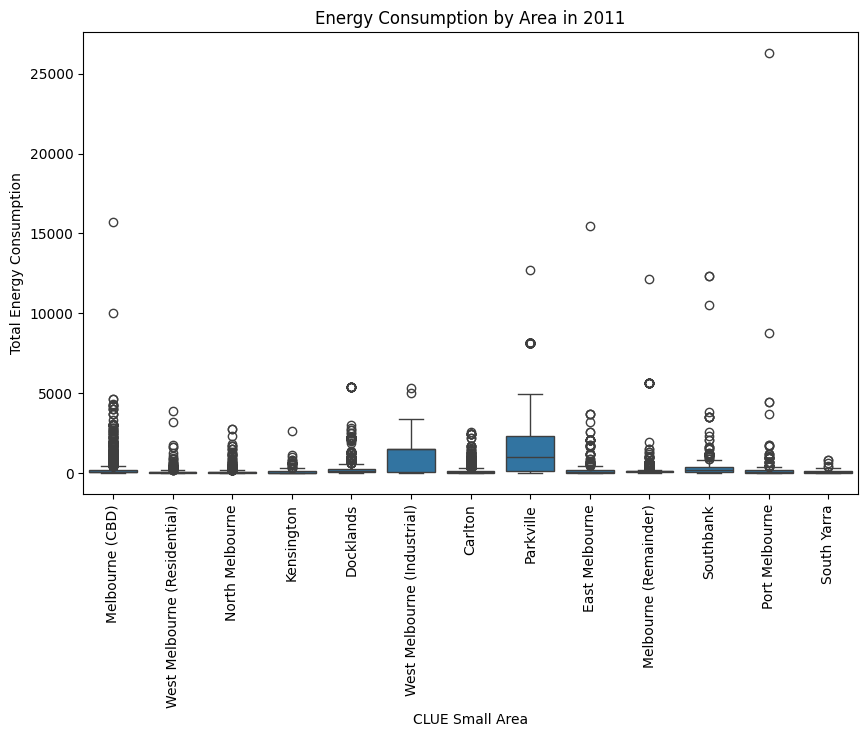

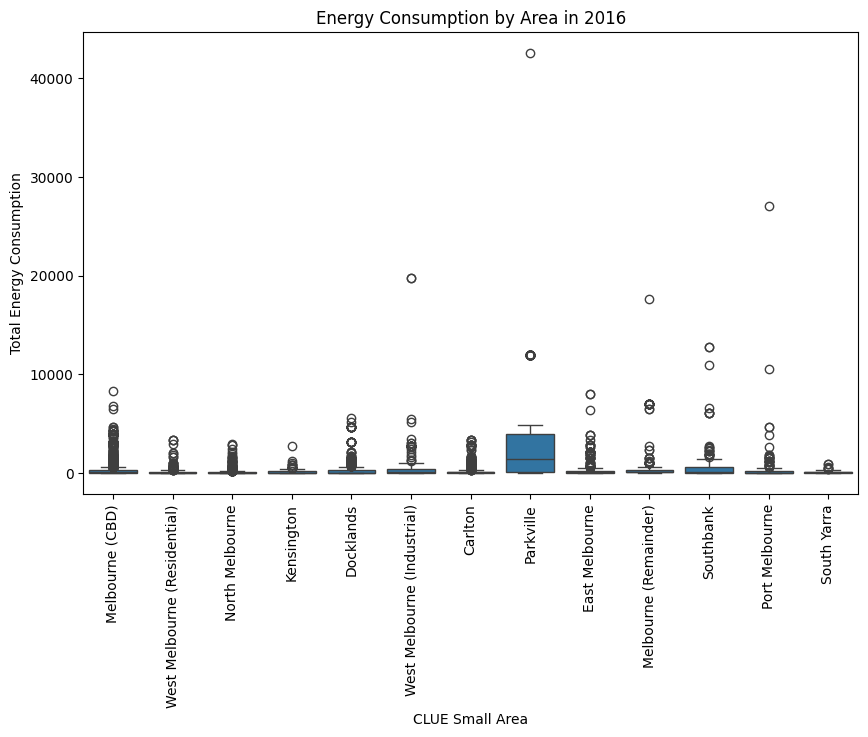

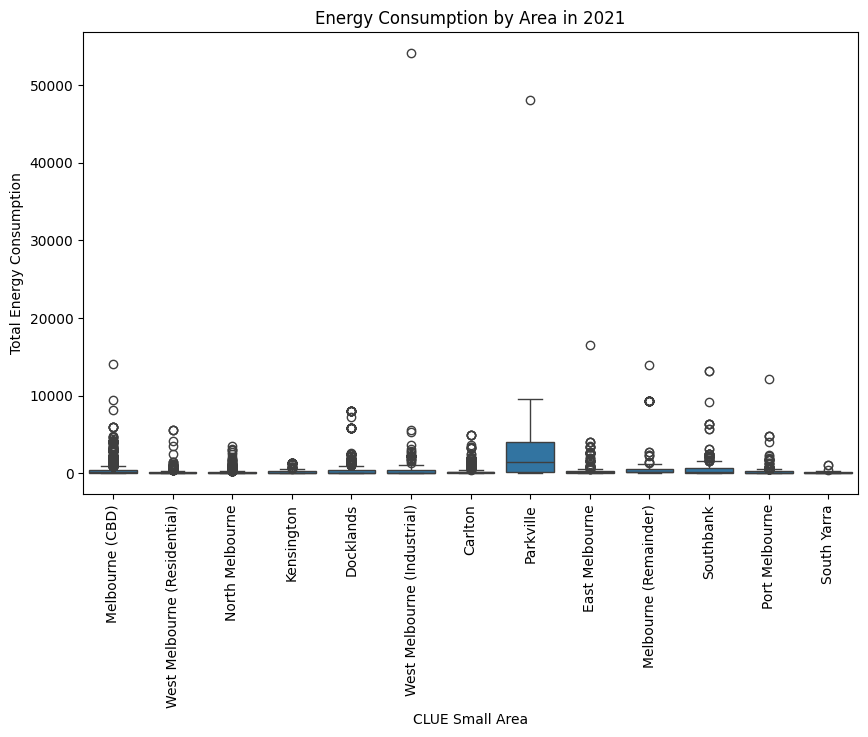

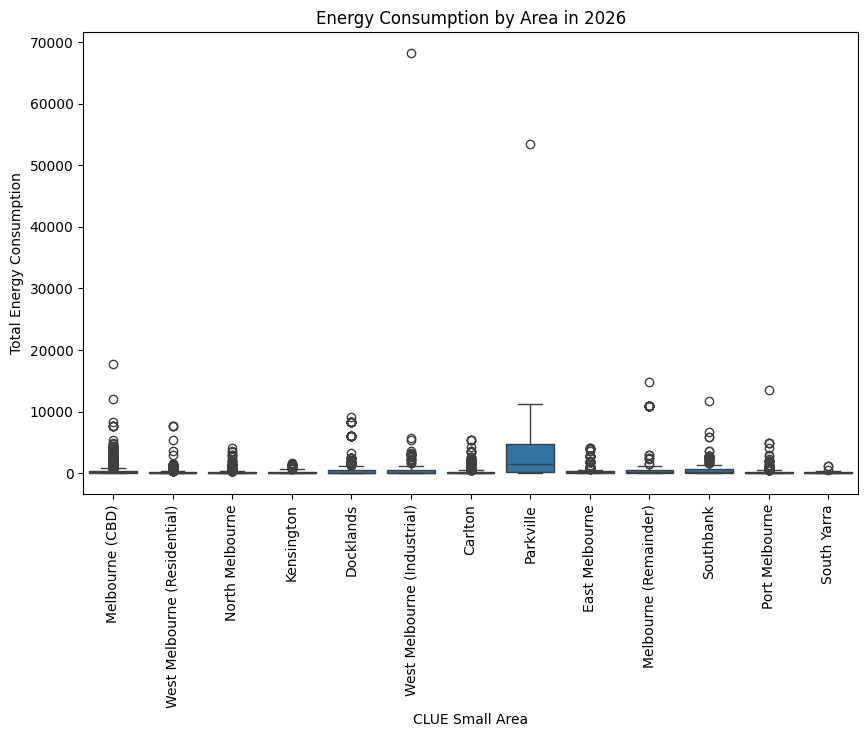

In [36]:
def plot_energyconsumption_by_area_per_year(dfs, years):
    """
    Plots individual boxplots of energy consumption for different areas, each plot corresponding to each year.

    Parameters:
    - dfs: list of DataFrames for each year.
    - years: list of years corresponding to each DataFrame.
    """

    for df, year in zip(dfs, years):
        # Prepare data for plotting
        df = df.copy()
        total_column = f'total_{year}'  # Adjust based on the provided structure

        # Check if the expected total column exists in the DataFrame
        if total_column not in df.columns:
            print(f"Column {total_column} does not exist in the DataFrame for the year {year}.")
            continue

        df['Year'] = year
        df.rename(columns={total_column: 'Total Energy Consumption'}, inplace=True)
        plot_data = df[['CLUE small area', 'Total Energy Consumption']]

        # New figure for each year
        plt.figure(figsize=(10, 6))
        sns.boxplot(x='CLUE small area', y='Total Energy Consumption', data=plot_data)
        plt.title(f'Energy Consumption by Area in {year}')
        plt.xlabel('CLUE Small Area')
        plt.ylabel('Total Energy Consumption')
        # Rotate x-axis labels for better readability
        plt.xticks(rotation=90)
        plt.show()

# Plotting the boxplot
plot_energyconsumption_by_area_per_year([df_2011, df_2016, df_2021, df_2026], [2011, 2016, 2021, 2026])

Remove outliers and visualise results

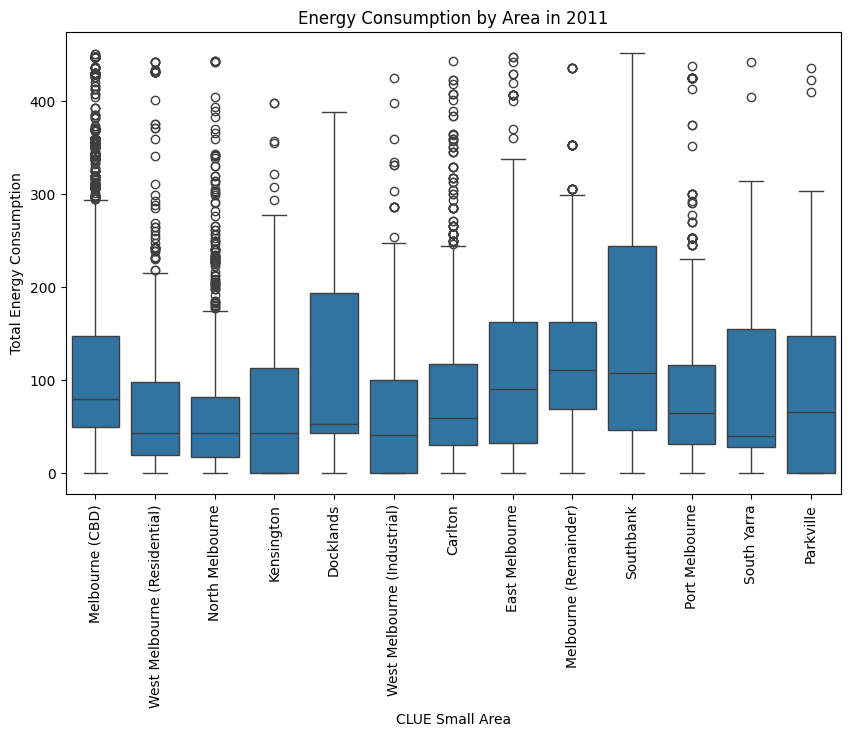

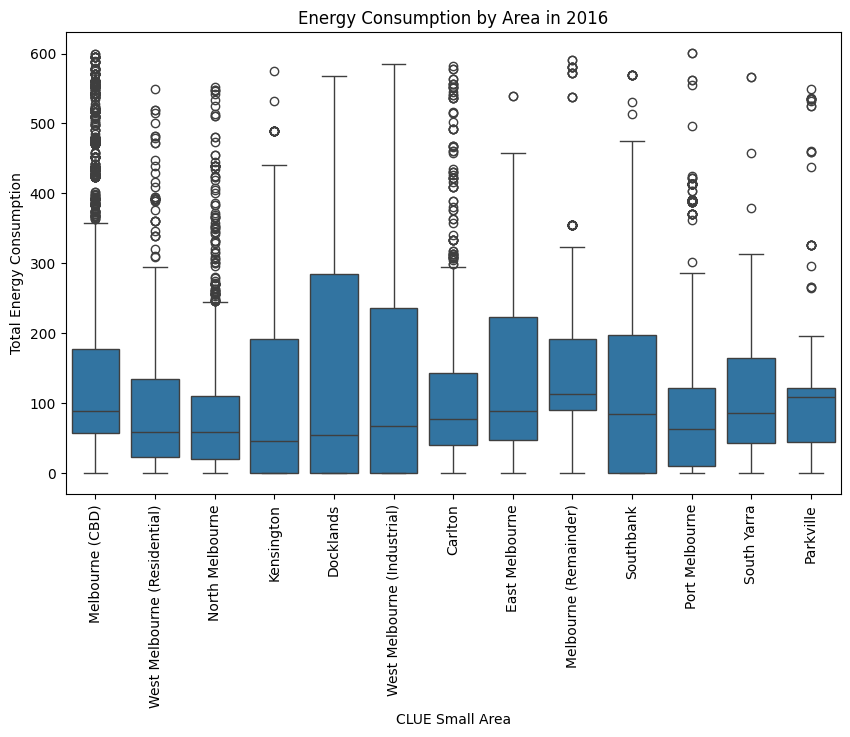

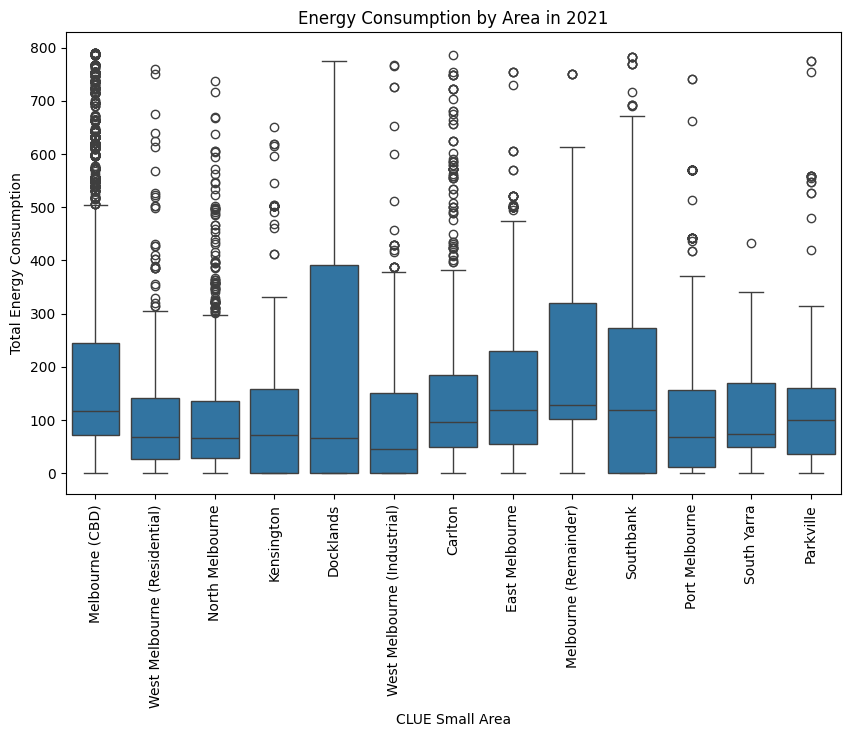

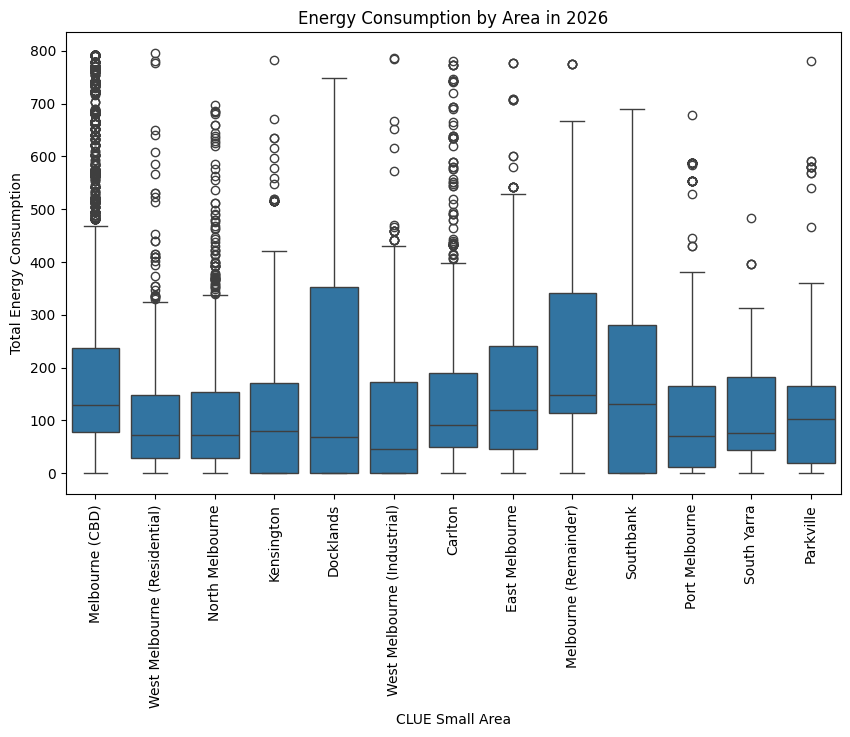

In [37]:
def remove_outliers(df, year):
    """
    Removes outliers from a DataFrame based on the IQR method.

    Parameters:
    df: DataFrame containing the data.
    column_name: str, the name of the column from which need to remove outliers.

    Returns:
    df: DataFrame with outliers removed.
    """

    total_column = f'total_{year}'

    Q1 = df[total_column].quantile(0.25)
    Q3 = df[total_column].quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR

    # Return the DataFrame without outliers
    return df[(df[total_column] >= lower_bound) & (df[total_column] <= upper_bound)]

df_2011 = remove_outliers(df_2011, '2011')
df_2016 = remove_outliers(df_2016, '2016')
df_2021 = remove_outliers(df_2021, '2021')
df_2026 = remove_outliers(df_2026, '2026')

plot_energyconsumption_by_area_per_year([df_2011, df_2016, df_2021, df_2026], [2011, 2016, 2021, 2026])

### Empty value handling

In [38]:
def remove_zero(df, year):
    """
    Removes all rows belonging to industries whose total sum for the specified year is zero.
    For the year 2026, it ignores the industry code totals.

    Parameters:
    df : DataFrame containing the data.
    year : str， The year column suffix in the DataFrame to identify the total column.

    Returns:
    df : DataFrame with zero total industries removed.
    """
    total_column = f'total_{year}'

    # Total energy consumption by Property ID
    property_totals = df.groupby('Property ID')[total_column].sum()
    # Property ID with extremely low energy consumption
    zero_total_properties = property_totals[property_totals == 0.0].index.tolist()
    # Delete corresponding data
    df = df[~df['Property ID'].isin(zero_total_properties)]

    # Delete of industries with extremely low energy consumption by industry code
    if year != '2026':
        industry_totals = df.groupby('Industry (ANZSIC4) code')[total_column].sum()
        zero_total_industries = industry_totals[industry_totals <= 5].index.tolist()
        df = df[~df['Industry (ANZSIC4) code'].isin(zero_total_industries)]

    return df

# Modifying Data with Functions
df_2011 = remove_zero(df_2011, '2011')
df_2016 = remove_zero(df_2016, '2016')
df_2021 = remove_zero(df_2021, '2021')
df_2026 = remove_zero(df_2026, '2026')


### Data visualisation

Total energy consumption in different sectors through bar charts

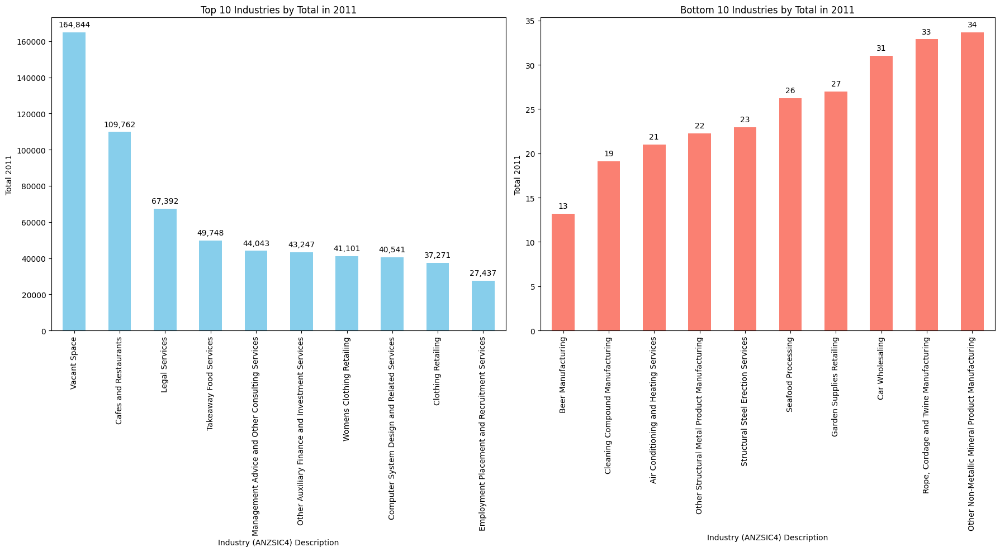

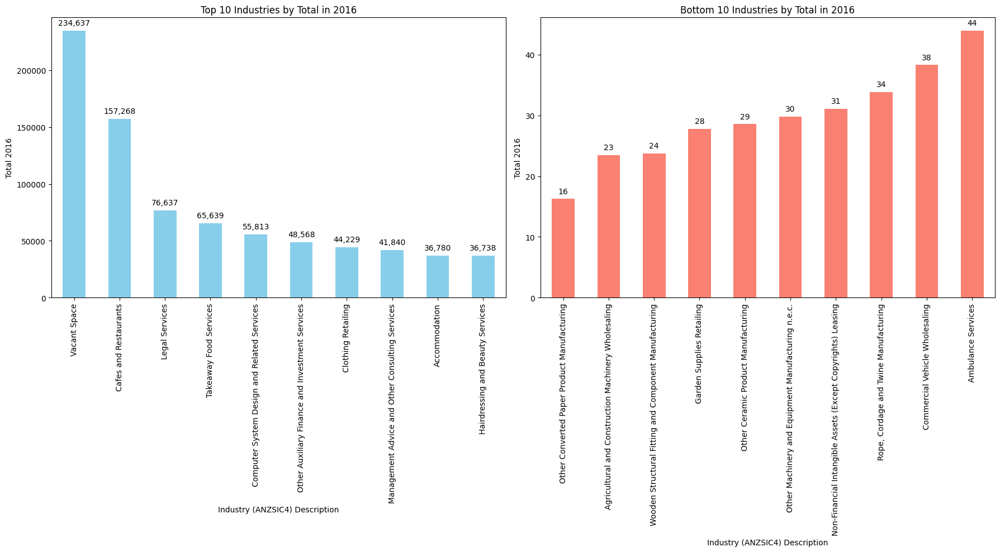

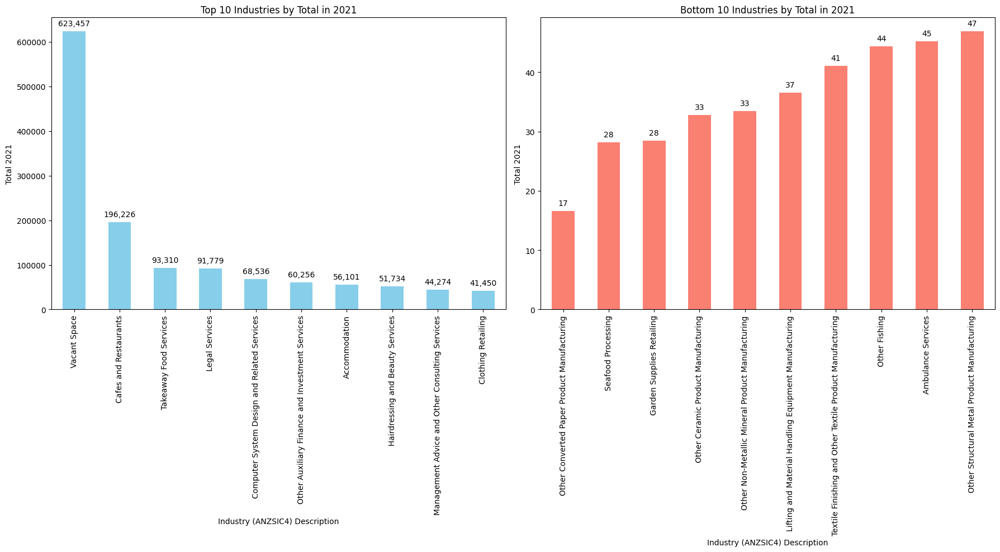

In [39]:
def plot_top_bottom_industries(df, year, n=10):
    """
    Plots top and bottom n industries by total for a given year, with labels on each bar,
    only if the total sum is not zero.

    Parameters:
    df : DataFrame containing the data.
    year : str， The year column suffix in the DataFrame to identify the total column.
    n : int - Number of top and bottom industries to display.
    """
    # Grouping by industry description and calculating the sum for the corresponding year
    total_column = f'total_{year}'
    industry_totals = df.groupby('Industry (ANZSIC4) description')[total_column].sum()

    # Select the highest and lowest industries
    top_industries = industry_totals.nlargest(n)
    bottom_industries = industry_totals.nsmallest(n)

    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(18, 10))

    # Plotting the highest energy-consuming industries
    top_industries.plot(kind='bar', color='skyblue', ax=ax1)
    ax1.set_title(f'Top {n} Industries by Total in {year}')
    ax1.set_xlabel('Industry (ANZSIC4) Description')
    ax1.set_ylabel(f'Total {year}')
    ax1.tick_params(axis='x', rotation=90)

    # Adding numeric labels to bar charts
    for p in ax1.patches:
        ax1.annotate(f'{p.get_height():,.0f}', (p.get_x() + p.get_width() / 2., p.get_height()),
                     ha='center', va='center', xytext=(0, 10), textcoords='offset points')

    # Plotting the lowest energy-consuming industries
    bottom_industries.plot(kind='bar', color='salmon', ax=ax2)
    ax2.set_title(f'Bottom {n} Industries by Total in {year}')
    ax2.set_xlabel('Industry (ANZSIC4) Description')
    ax2.set_ylabel(f'Total {year}')
    ax2.tick_params(axis='x', rotation=90)
    # Adding numeric labels to bar charts
    for p in ax2.patches:
        ax2.annotate(f'{p.get_height():,.0f}', (p.get_x() + p.get_width() / 2., p.get_height()),
                     ha='center', va='center', xytext=(0, 10), textcoords='offset points')

    plt.tight_layout()
    plt.show()

plot_top_bottom_industries(df_2011, '2011')
plot_top_bottom_industries(df_2016, '2016')
plot_top_bottom_industries(df_2021, '2021')

**Result Analysis**  
There are a large number of vacant areas in Melbourne's city area that still consume a large amount of energy and cause energy wastage.

#### Re-aggregate data and perform data visualisation based on geo-location information

In [40]:
# Standardization of the energy-consumption columns
df_2011['Energy Consumption'] = df_2011['total_2011']
df_2016['Energy Consumption'] = df_2016['total_2016']
df_2021['Energy Consumption'] = df_2021['total_2021']
df_2026['Energy Consumption'] = df_2026['total_2026']

# Merge datasets
frames = [df_2011, df_2016, df_2021, df_2026]
model_gdf = pd.concat(frames)

In [41]:
model_gdf

,Census year,Block ID,Property ID,CLUE small area,Trading name,Business address,Industry (ANZSIC4) code,Industry (ANZSIC4) description,Geo Point,geometry,total_2011,property_id,floor_area,Energy Consumption,total_2016,total_2021,total_2026
15,2011,1,108843,Melbourne (CBD),Citipower Pty,"Substation 142, Rear 581 Spencer Street MELBOU...",2630.0,Electricity Distribution,"-37.82161126424501, 144.95659341052604","MULTIPOLYGON (((144.95764 -37.82094, 144.95771...",11.793032,108843.0,0.00,11.793032,NaN,NaN,NaN
16,2011,1,108843,Melbourne (CBD),Foot & Body (8),8 Spencer Street MELBOURNE 3000,9511.0,Hairdressing and Beauty Services,"-37.82161126424501, 144.95659341052604","MULTIPOLYGON (((144.95764 -37.82094, 144.95771...",11.793032,108843.0,0.00,11.793032,NaN,NaN,NaN
17,2011,1,108843,Melbourne (CBD),The Clothesline Collective,62 Spencer Street MELBOURNE 3000,4255.0,Womens Clothing Retailing,"-37.82161126424501, 144.95659341052604","MULTIPOLYGON (((144.95764 -37.82094, 144.95771...",11.793032,108843.0,0.00,11.793032,NaN,NaN,NaN
18,2011,1,108843,Melbourne (CBD),Vacant,44 Spencer Street MELBOURNE 3000,0.0,Vacant Space,"-37.82161126424501, 144.95659341052604","MULTIPOLYGON (((144.95764 -37.82094, 144.95771...",11.793032,108843.0,0.00,11.793032,NaN,NaN,NaN
19,2011,1,108843,Melbourne (CBD),Vacant,2 Spencer Street MELBOURNE 3000,0.0,Vacant Space,"-37.82161126424501, 144.95659341052604","MULTIPOLYGON (((144.95764 -37.82094, 144.95771...",11.793032,108843.0,0.00,11.793032,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
49456,2026,357,105035,North Melbourne,NaN,NaN,NaN,NaN,"-37.80436576436303, 144.95418669327805","MULTIPOLYGON (((144.95430 -37.80433, 144.95428...",NaN,105035.0,730.80,475.503940,NaN,NaN,475.503940
49457,2026,361,106990,North Melbourne,NaN,NaN,NaN,NaN,"-37.80543035745161, 144.9578299828369","MULTIPOLYGON (((144.95771 -37.80555, 144.95768...",NaN,106990.0,0.00,369.713308,NaN,NaN,369.713308
49458,2026,418,104738,West Melbourne (Residential),NaN,NaN,NaN,NaN,"-37.80922785700179, 144.94505794304052","MULTIPOLYGON (((144.94518 -37.80926, 144.94519...",NaN,104738.0,219.70,37.672850,NaN,NaN,37.672850
49460,2026,606,110016,East Melbourne,NaN,NaN,NaN,NaN,"-37.8166280648155, 144.98963209678806","MULTIPOLYGON (((144.98969 -37.81652, 144.98968...",NaN,110016.0,261.90,76.374827,NaN,NaN,76.374827


**Via an interactive map that shows the number of trades for different property IDs in different years.**

In [46]:
# Convert DataFrame to GeoDataFrame
gdf = gpd.GeoDataFrame(model_gdf, geometry=gpd.points_from_xy(model_gdf['Geo Point'].apply(
    lambda x: float(x.split(',')[1])), model_gdf['Geo Point'].apply(lambda x: float(x.split(',')[0]))))

# Calculate the number of trades per property ID per year
gdf['industry_count'] = gdf.groupby(['Property ID', 'Census year'])['Industry (ANZSIC4) code'].transform('nunique')

# Setting the map plotting function
def plot_industry_count_by_year_interactive():
    # Initialise map
    m = folium.Map(
        location=[-37.8136, 144.9631],
        zoom_start=12)
    layers = {}

    # Processing each year
    for year in [2011, 2016, 2021]:
        marker_cluster = MarkerCluster(name=str(year), show=False)

        # Add markers to the map
        for _, row in gdf[gdf['Census year'] == year].iterrows():
            folium.Marker(
                location=[row.geometry.y, row.geometry.x],
                icon=folium.DivIcon(html=f"""
                <div style="font-family: 'Arial'; color: 'blue'; font-size: 12pt">
                {row['industry_count']}</div>""")
            ).add_to(marker_cluster)

        marker_cluster.add_to(m)
        layers[str(year)] = marker_cluster

    # Initial visibility of first layer
    layers['2011'].show = True

    folium.LayerControl().add_to(m)
    return m

# Display interactive map
map_display = plot_industry_count_by_year_interactive()
map_display


**Plot geographic charts to visualise the properties with the highest energy consumption in a given year.**

Location of individual businesses with highest energy consumption

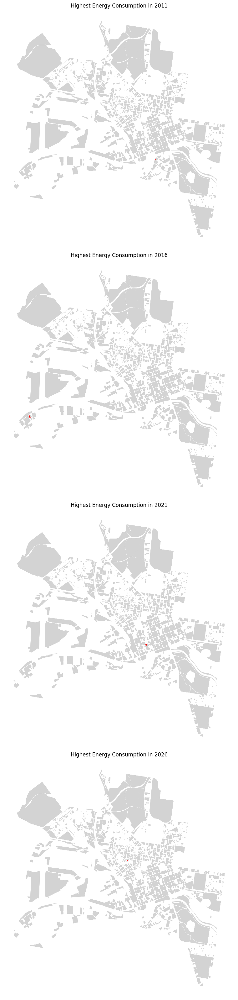

In [ ]:
def plot_highest_business_energyconsumption(gdf, years):
    """
    Plot the highest energy-consuming business for given years.

    Parameters:
    gdf: GeoDataFrame containing the property data.
    years: List of years to consider.
    """
    # Each sub-chart has a height of 8
    fig_height = 8 * len(years)
    fig, axs = plt.subplots(nrows=len(years), ncols=1, figsize=(10, fig_height))

    if len(years) == 1:
      # Make sure axs is iterable
      axs = [axs]

    for year, ax in zip(years, axs):
      total_column = f'total_{year}'

      # Ensure the column exists
      if total_column not in gdf.columns:
        print(f"Column {total_column} does not exist in the GeoDataFrame.")
        continue

      # Find the property with the highest energy consumption for the year
      max_property = gdf[gdf[total_column] == gdf[total_column].max()]

      # Plot the GeoDataFrame highlighting the max property
      # Plot all properties in light grey
      gdf.plot(ax=ax, color='lightgrey')
      # Plot the highest consuming property in red
      max_property.plot(ax=ax, color='red', legend=True)

      # Setting title
      ax.set_title(f'Highest Energy Consumption in {year}')
      ax.set_axis_off()

    plt.tight_layout()
    plt.show()

# Use function to show location of business with highest energy consumption
plot_highest_business_energyconsumption(model_gdf, [2011, 2016, 2021, 2026])

Location of properties with highest energy consumption

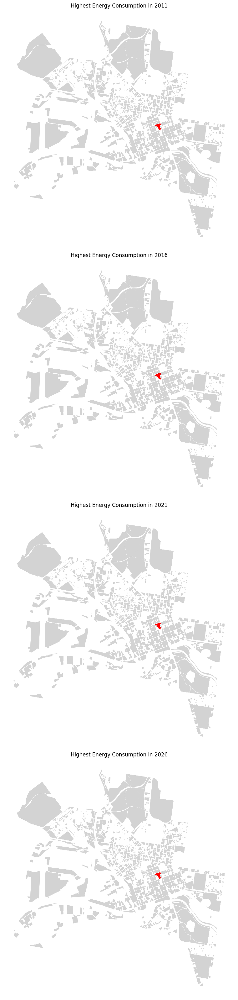

In [ ]:
def plot_highest_energy_consumption(gdf, years):
    """
    Plot the highest energy-consuming properties for given years.

    Parameters:
    gdf: GeoDataFrame containing the property data.
    years: List of years to consider.
    """

    # Each sub-chart has a height of 8
    fig_height = 8 * len(years)
    fig, axs = plt.subplots(nrows=len(years), ncols=1, figsize=(10, fig_height))

    if len(years) == 1:
      # Make sure axs is iterable
      axs = [axs]

    for year, ax in zip(years, axs):
      total_column = f'total_{year}'


      # Ensure the column exists
      if total_column not in gdf.columns:
        print(f"Column {total_column} does not exist in the GeoDataFrame.")
        continue

      # Aggregate energy consumption by Property ID for the year
      aggregated_energy = gdf.groupby('Property ID')[total_column].sum()

      # Find the property ID with the highest total energy consumption
      max_property_id = aggregated_energy.idxmax()
      max_energy = aggregated_energy.max()

      # Select the property with the highest total energy consumption
      max_property = gdf[gdf['Property ID'] == max_property_id]

      # Plot the GeoDataFrame highlighting the max property
      # Plot all properties in light grey
      gdf.plot(ax=ax, color='lightgrey')
      # Plot the highest consuming property in red
      max_property.plot(ax=ax, color='red', legend=True)

      # Setting title
      ax.set_title(f'Highest Energy Consumption in {year}')
      ax.set_axis_off()

    plt.tight_layout()
    plt.show()

# Use function to show location of property with highest energy consumption
plot_highest_energy_consumption(model_gdf, [2011, 2016, 2021, 2026])

Plotting energy consumption for each CLUE small area in different years

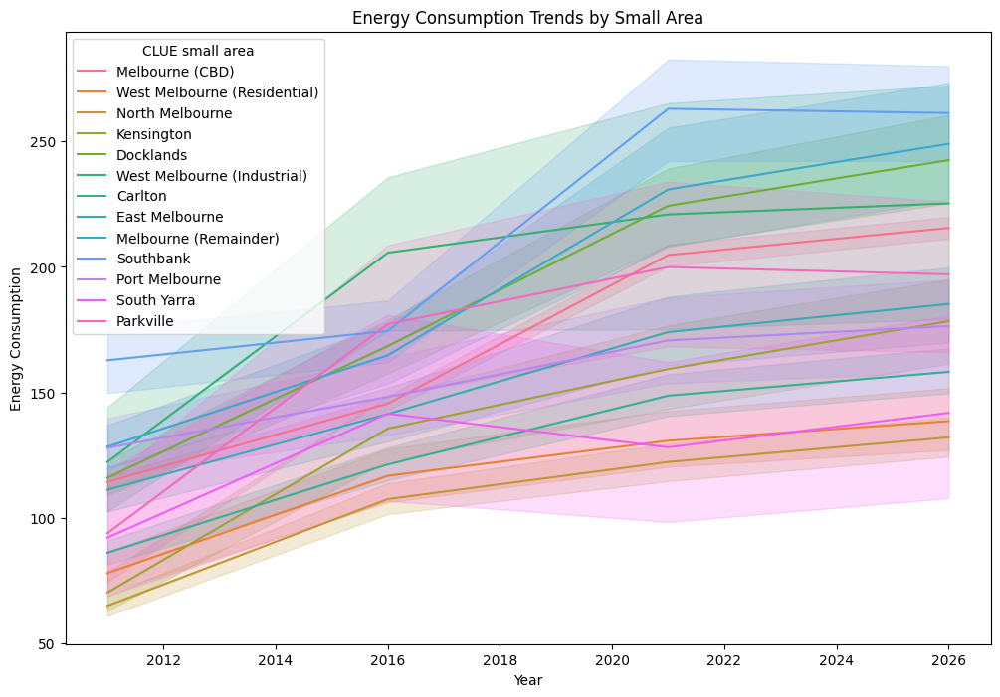

In [ ]:
plt.figure(figsize=(12, 8))
sns.lineplot(data=model_gdf, x='Census year', y='Energy Consumption', hue='CLUE small area')
plt.title('Energy Consumption Trends by Small Area')
plt.xlabel('Year')
plt.ylabel('Energy Consumption')
plt.show()

Plot the distribution of energy consumption in the property for the corresponding years

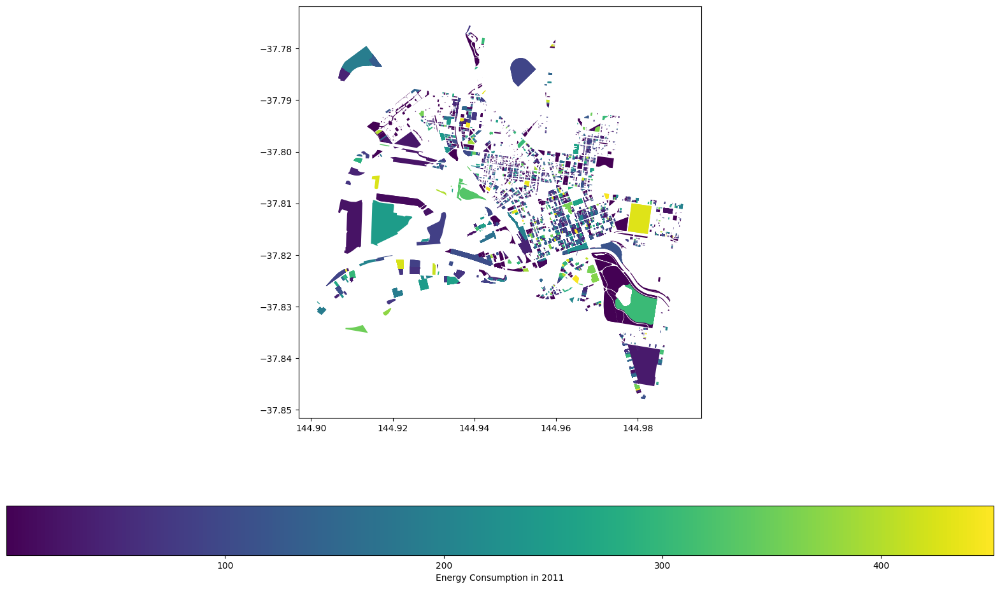

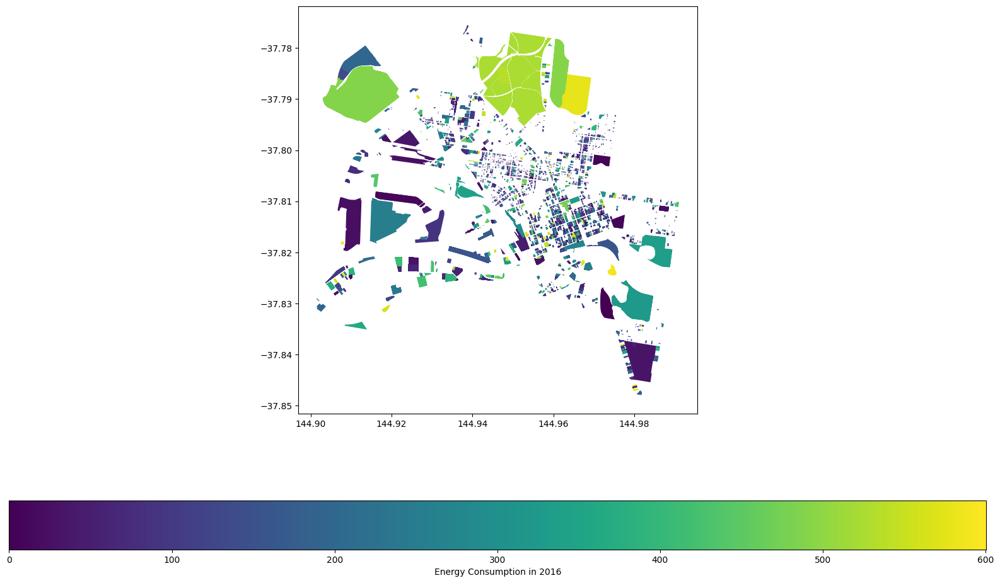

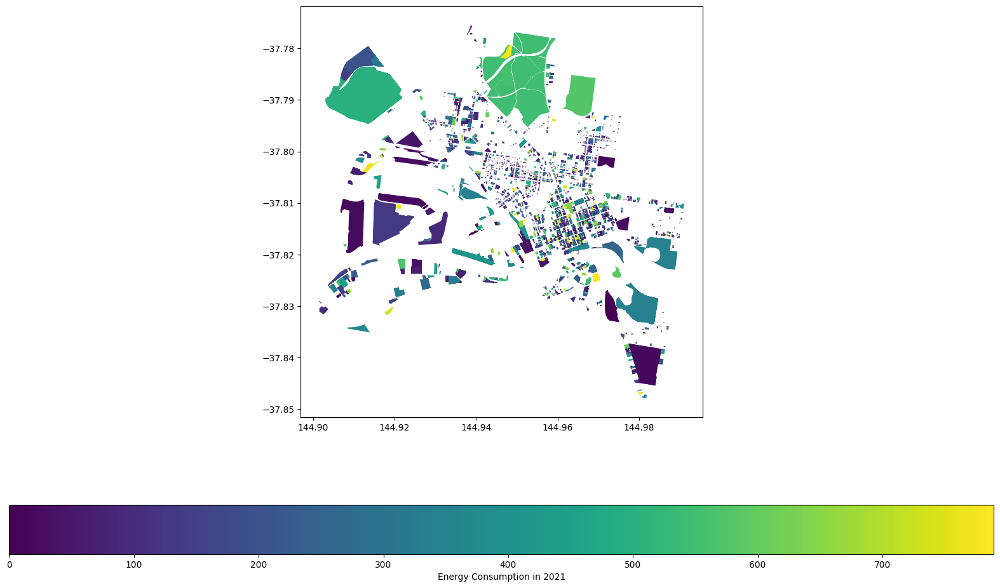

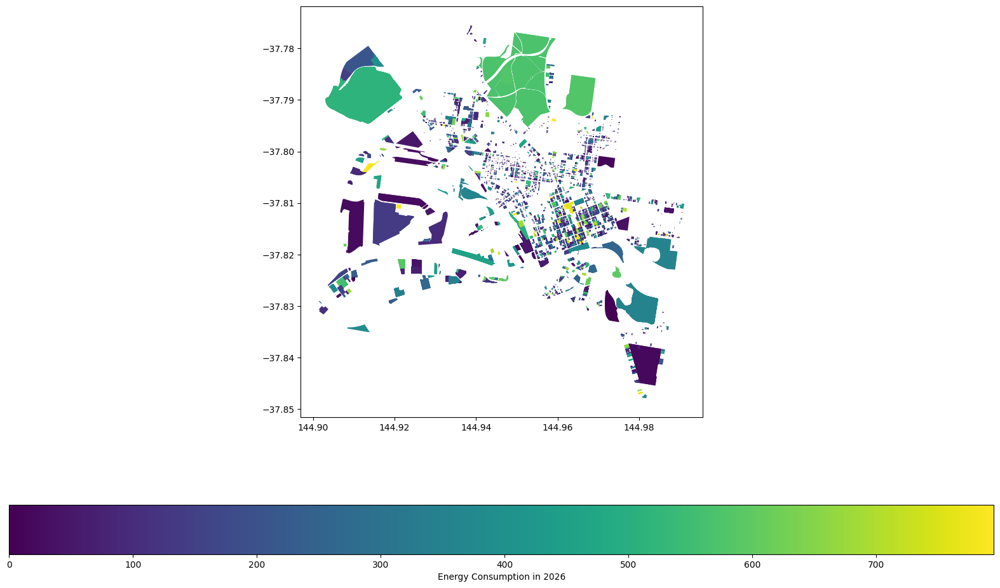

In [ ]:
def plot_energy_consumption_normalized(df, year):
    """
    Plot the normalized energy consumption distribution for properties in corresponding year.

    Parameters:
    df : DataFrame containing the energy consumption data.
    year : The year for which the energy consumption is to be plotted.
    """

    # Filter data according to selected years
    if year not in [2011, 2016, 2021, 2026]:
      print("Unsupported year.")
      return

    # Creating a Data Copy
    df_copy = df.copy()

    # Select column corresponding to energy consumption according to the year
    total_column = f"total_{year}"

    # Check the column exists in DataFrame
    if total_column not in df_copy.columns:
      print(f"The column '{total_column}' does not exist in the DataFrame.")
      return

    # Aggregate energy consumption by Property ID for the year
    aggregated_energy = df_copy.groupby('Property ID')[total_column].sum().reset_index()

    # Merge aggregated consumption back to DataFrame
    df_copy = df_copy.merge(aggregated_energy, on='Property ID', how='left', suffixes=('', '_agg'))

    # Normalisation of energy consumption data
    df_copy[total_column + '_agg'] = (
        df_copy[total_column + '_agg'] - df_copy[total_column + '_agg'].min()) / (
            df_copy[total_column + '_agg'].max() - df_copy[total_column + '_agg'].min())

    # Plot the distribution of energy consumption
    fig, ax = plt.subplots(1, 1, figsize=(20, 12))
    df_copy.plot(column=total_column, ax=ax, legend=True,
             legend_kwds={'label': f"Energy Consumption in {year}", 'orientation': "horizontal"})
    plt.show()

plot_energy_consumption_normalized(df_2011, 2011)
plot_energy_consumption_normalized(df_2016, 2016)
plot_energy_consumption_normalized(df_2021, 2021)
plot_energy_consumption_normalized(df_2026, 2026)

**Result Analysis**  
Individual businesses may have significant energy consumption, but will not have an impact on total energy consumption at the property level.

Plotting scatter plots between floor area versus energy consumption for properties in different years.

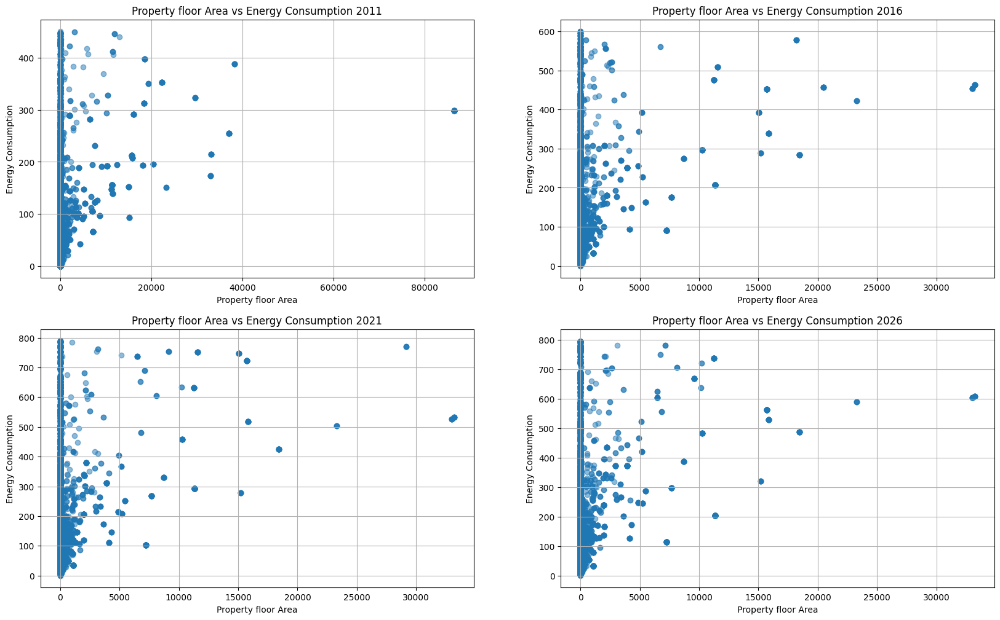

In [ ]:
def plot_floor_area_vs_energy_consumption(dfs, years):
    """
    Plots scatter plots of floor area versus energy consumption.

    Parameters:
    dfs: List of DataFrames for each year.
    years: List of years corresponding to each DataFrame.
    """
    # Ensure the figure is large enough to accommodate all subplots
    plt.figure(figsize=(20, 12))

    # Loop through each DataFrame and corresponding year
    for i, (df, year) in enumerate(zip(dfs, years)):
      # Assume a 2x2 subplot layout
      plt.subplot(2, 2, i + 1)
      # Construct the column name based on the year
      total_column = f'total_{year}'

      # Ensure the expected total column exists in the DataFrame
      if total_column not in df.columns:
        print(f"Column {total_column} does not exist in the DataFrame for the year {year}.")
        continue

      # Plot scatter plot for the current year
      plt.scatter(df['floor_area'], df[total_column], alpha=0.5)
      plt.title(f'Property floor Area vs Energy Consumption {year}')
      plt.xlabel('Property floor Area')
      plt.ylabel('Energy Consumption')
      plt.grid(True)

    # Ensure the layout is clean and no labels are overlapping
    plt.show()

plot_floor_area_vs_energy_consumption([df_2011, df_2016, df_2021, df_2026], [2011, 2016, 2021, 2026])

**Result Analysis**  
Since the floor area of properties with the property type "vacant" in the statistics is zero, we can confirm that energy is being wasted by a large number of vacant properties by combining the results of the previous statistics.

## Part 2

### Machine Learning

Organise the dataset, eliminating data not needed for machine learning and checking the dataset for null values..

In [ ]:
df_ml = model_gdf.drop(columns=[
    'Trading name',
    'Business address', 'Geo Point',
    'geometry', 'total_2011', 'property_id',
    'total_2016', 'total_2021', 'total_2026'])

# Check for null value for data except 2026
non_data = df_ml[df_ml['Census year'] != 2026]
missing_values = non_data.isnull().sum()

# Printing statistics of missing values
print(missing_values)

Census year                       0
Block ID                          0
Property ID                       0
CLUE small area                   0
Industry (ANZSIC4) code           0
Industry (ANZSIC4) description    0
floor_area                        0
Energy Consumption                0
dtype: int64


In [ ]:
df_ml

,Census year,Block ID,Property ID,CLUE small area,Industry (ANZSIC4) code,Industry (ANZSIC4) description,floor_area,Energy Consumption
15,2011,1,108843,Melbourne (CBD),2630.0,Electricity Distribution,0.00,11.793032
16,2011,1,108843,Melbourne (CBD),9511.0,Hairdressing and Beauty Services,0.00,11.793032
17,2011,1,108843,Melbourne (CBD),4255.0,Womens Clothing Retailing,0.00,11.793032
18,2011,1,108843,Melbourne (CBD),0.0,Vacant Space,0.00,11.793032
19,2011,1,108843,Melbourne (CBD),0.0,Vacant Space,0.00,11.793032
...,...,...,...,...,...,...,...,...
49456,2026,357,105035,North Melbourne,NaN,NaN,730.80,475.503940
49457,2026,361,106990,North Melbourne,NaN,NaN,0.00,369.713308
49458,2026,418,104738,West Melbourne (Residential),NaN,NaN,219.70,37.672850
49460,2026,606,110016,East Melbourne,NaN,NaN,261.90,76.374827


Identify cross-references between industry descriptions and codes based on available data

In [ ]:
# Filtered data for 2011, 2016 and 2021
df_filtered = df_ml[df_ml['Census year'].isin([2011, 2016, 2021])]

# Extract industry code and industry description cross-reference
industry_mapping = df_filtered[['Industry (ANZSIC4) code', 'Industry (ANZSIC4) description']].drop_duplicates()

# Check if there are industry codes corresponding to multiple descriptions
if industry_mapping['Industry (ANZSIC4) code'].duplicated().any():
  print("Warning: There are multiple descriptions for a single industry code")
else:
  print("Each industry code has a unique corresponding description")

# Display Comparison Table
industry_mapping

Each industry code has a unique corresponding description


,Industry (ANZSIC4) code,Industry (ANZSIC4) description
15,2630.0,Electricity Distribution
16,9511.0,Hairdressing and Beauty Services
17,4255.0,Womens Clothing Retailing
18,0.0,Vacant Space
22,4310.0,Non-Store Retailing
...,...,...
34631,2312.0,Motor Vehicle Body and Trailer Manufacturing
35328,1813.0,Basic Inorganic Chemical Manufacturing
35331,149.0,Other Grain Growing
37043,1162.0,"Cereal, Pasta and Baking Mix Manufacturing"


Corresponding industries on the property are projected for 2026 based on three years of data from 2011, 2016, and 2021

In [ ]:
# Creating copies of datasets for machine learning
df_final = df_ml.copy()

# Setting features and target columns
features = ['Census year', 'Block ID', 'Property ID', 'CLUE small area', 'floor_area', 'Energy Consumption']
target = 'Industry (ANZSIC4) code'

# Separate out the portion of the data used for prediction and the portion used for training
train_data = df_final[df_final['Census year'] != 2026]
predict_data = df_final[df_final['Census year'] == 2026]

# Processing categorised data and converting non-numeric columns
le_area = LabelEncoder()
train_data.loc[:, 'CLUE small area'] = le_area.fit_transform(train_data['CLUE small area'])
predict_data.loc[:, 'CLUE small area'] = le_area.transform(predict_data['CLUE small area'])

# Prepare training and test data
X_train, X_test, y_train, y_test = train_test_split(
    train_data[features], train_data[target], test_size=0.3, random_state=42
    )

# Model training
model = RandomForestClassifier(
    n_estimators=200, max_depth=20, min_samples_split=2, random_state=42
    )
model.fit(X_train, y_train)

# Model evaluation
y_pred = model.predict(X_test)
print(f"Accuracy: {accuracy_score(y_test, y_pred)}")
print(f"F1 Score: {f1_score(y_test, y_pred, average='weighted')}")
print(f"Precision: {precision_score(y_test, y_pred, average='weighted')}")

Accuracy: 0.2223060164236635
F1 Score: 0.1799708008461471
Precision: 0.1701634047056715


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [ ]:
# Creating copies of datasets for machine learning
svm_df_final = df_ml.copy()

# Setting features and target columns
svm_features = ['Census year', 'Block ID', 'Property ID', 'CLUE small area', 'floor_area', 'Energy Consumption']
svm_target = 'Industry (ANZSIC4) code'

# Separate out the portion of the data used for prediction and the portion used for training
svm_train_data = svm_df_final[svm_df_final['Census year'] != 2026]
svm_predict_data = svm_df_final[svm_df_final['Census year'] == 2026]

# Processing categorised data and converting non-numeric columns
svm_le_area = LabelEncoder()
svm_train_data['CLUE small area'] = svm_le_area.fit_transform(svm_train_data['CLUE small area'])
svm_predict_data['CLUE small area'] = svm_le_area.transform(svm_predict_data['CLUE small area'])

# Prepare training and test data
svm_X_train, svm_X_test, svm_y_train, svm_y_test = train_test_split(
    svm_train_data[svm_features], svm_train_data[svm_target], test_size=0.3, random_state=42
)

# Model training using SVM
svm_model = SVC(kernel='rbf', C=1.0, random_state=42)
svm_model.fit(svm_X_train, svm_y_train)

# Model evaluation
svm_y_pred = svm_model.predict(svm_X_test)
svm_accuracy = accuracy_score(svm_y_test, svm_y_pred)
svm_f1 = f1_score(svm_y_test, svm_y_pred, average='weighted')
svm_precision = precision_score(svm_y_test, svm_y_pred, average='weighted')

print(f"SVM Accuracy: {svm_accuracy}")
print(f"SVM F1 Score: {svm_f1}")
print(f"SVM Precision: {svm_precision}")

<ipython-input-25-ff11dbd2524b>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  svm_train_data['CLUE small area'] = svm_le_area.fit_transform(svm_train_data['CLUE small area'])
<ipython-input-25-ff11dbd2524b>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  svm_predict_data['CLUE small area'] = svm_le_area.transform(svm_predict_data['CLUE small area'])


SVM Accuracy: 0.18183341712753479
SVM F1 Score: 0.055952710602205115
SVM Precision: 0.03306339158427606


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Use the most appropriate model to obtain predictions

In [ ]:
# Using Models for Prediction
predict_data['Predicted Industry (ANZSIC4) code'] = model.predict(predict_data[features])

# Update industry codes for 2026 in the dataset
df_final.loc[df_final['Census year'] == 2026, 'Industry (ANZSIC4) code'] = predict_data['Predicted Industry (ANZSIC4) code']

# Checking the updated data
print(df_final[df_final['Census year'] == 2026][['Census year', 'Property ID', 'Industry (ANZSIC4) code']])

       Census year  Property ID  Industry (ANZSIC4) code
0             2026       108843                      0.0
1             2026       108843                      0.0
2             2026       108843                      0.0
3             2026       108843                      0.0
4             2026       108843                      0.0
...            ...          ...                      ...
49456         2026       105035                   4400.0
49457         2026       106990                   4400.0
49458         2026       104738                   6923.0
49460         2026       110016                      0.0
49461         2026       109621                   8512.0

[13041 rows x 3 columns]


<ipython-input-26-8bd8ec6dbada>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  predict_data['Predicted Industry (ANZSIC4) code'] = model.predict(predict_data[features])


Integrate and export final results

In [ ]:
# Delete the column "Industry (ANZSIC4) description" from the original dataset.
if 'Industry (ANZSIC4) description' in df_final.columns:
    df_final.drop('Industry (ANZSIC4) description', axis=1, inplace=True)

# Add description to df_final
df_final = df_final.merge(industry_mapping, on='Industry (ANZSIC4) code', how='left')

# Check results
df_final

,Census year,Block ID,Property ID,CLUE small area,Industry (ANZSIC4) code,floor_area,Energy Consumption,Industry (ANZSIC4) description
0,2011,1,108843,Melbourne (CBD),2630.0,0.00,11.793032,Electricity Distribution
1,2011,1,108843,Melbourne (CBD),9511.0,0.00,11.793032,Hairdressing and Beauty Services
2,2011,1,108843,Melbourne (CBD),4255.0,0.00,11.793032,Womens Clothing Retailing
3,2011,1,108843,Melbourne (CBD),0.0,0.00,11.793032,Vacant Space
4,2011,1,108843,Melbourne (CBD),0.0,0.00,11.793032,Vacant Space
...,...,...,...,...,...,...,...,...
52815,2026,357,105035,North Melbourne,4400.0,730.80,475.503940,Accommodation
52816,2026,361,106990,North Melbourne,4400.0,0.00,369.713308,Accommodation
52817,2026,418,104738,West Melbourne (Residential),6923.0,219.70,37.672850,Engineering Design and Engineering Consulting ...
52818,2026,606,110016,East Melbourne,0.0,261.90,76.374827,Vacant Space


# Conclusion

1. As can be seen from the available data, the industrial types that consume the most energy in the Melbourne City Region have not changed much. But vacant properties cause increasing energy consumption, which undoubtedly results in a lot of wasted energy.As a whole, energy consumption is increasing year on year, but there is a slowdown in growth after 2021.  
2. In machine learning, the Random Forest algorithm is more applicable to the current problem than SVM, but still suffers from not good enough performance. Subsequently, other models should be tried, such as GBM, deep learning models, and data cleaning and preprocessing using more appropriate methods.

